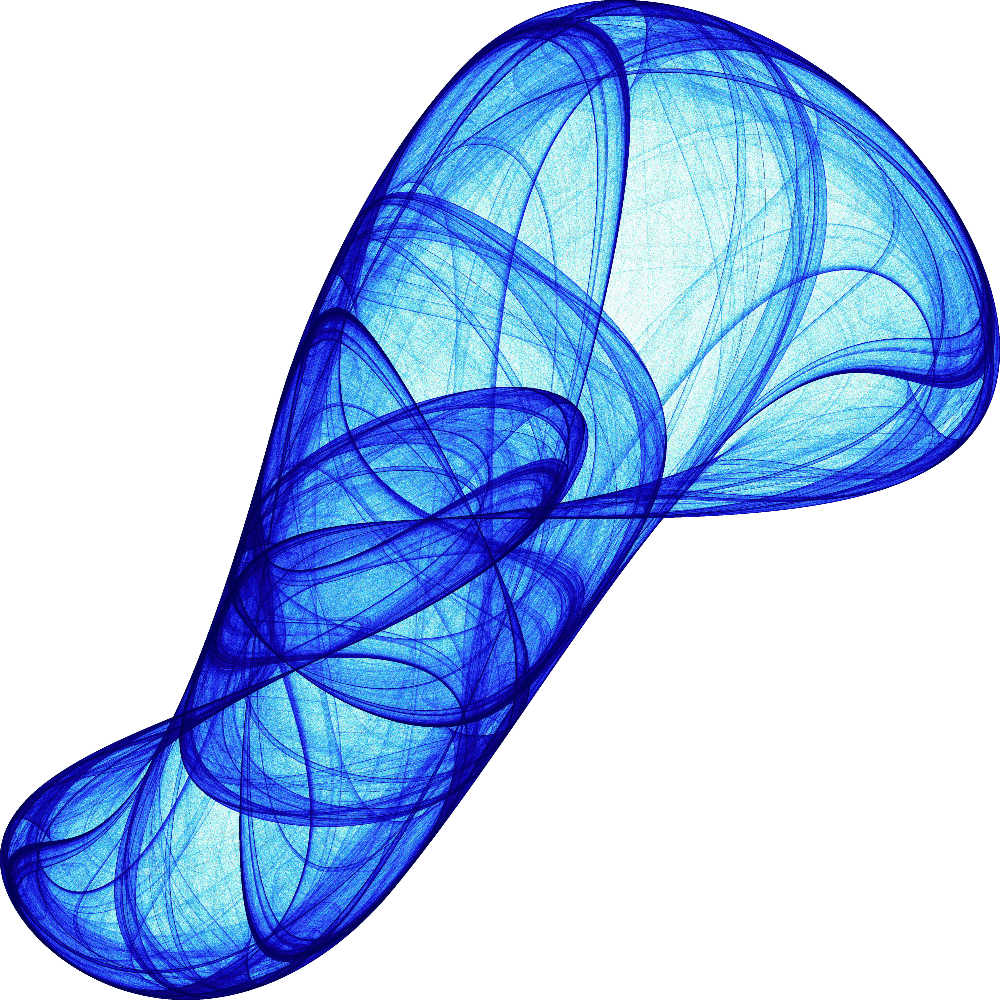

In [6]:
import numpy as np, pandas as pd, datashader as ds
from datashader import transfer_functions as tf
from datashader.colors import inferno, viridis
from numba import jit
from colorcet import palette


@jit
def clifford(a, b, c, d, x, y):
    return np.sin(a * y) + c * np.cos(a * x), \
           np.sin(b * x) + d * np.cos(b * y)

@jit
def dejong(a, b, c, d, x, y):
    return np.sin(a * y) - np.cos(b * x), \
           np.sin(c * x) - np.cos(d * y)

n=100000000

@jit
def trajectory(fn, a, b, c, d, x0=0, y0=0, n=n):
    x, y = np.zeros(n), np.zeros(n)
    x[0], y[0] = x0, y0
    for i in np.arange(n-1):
        x[i+1], y[i+1] = fn(a, b, c, d, x[i], y[i])
    return pd.DataFrame(dict(x=x,y=y))


df = trajectory(dejong, -0.709,  1.638,  0.452,  1.740, 0, 0)

cvs = ds.Canvas(plot_width = 4000, plot_height = 4000)
agg = cvs.points(df, 'x', 'y')


ds.transfer_functions.Image.border=0

tf.Image(tf.shade(agg, cmap = palette["kbc"][::-1]))